# Activity 8 - Interaction and Animation

We saw in our previous notebook how to create visualisations using matplotlib, seaborn, and pandas - however, in most cases these were static. We did get some interaction through the 3D plots and through using the Plotly library. Here, we are going to pursue this further, and look at how we can incorporate interaction and animation into our tools.

In particular, interaction techniques are useful for creatng dashboards (visual analytics) interfaces. Animations can be useful for conveying the story, by linking multiple still images together or by showing the analytical process.

In this example notebook, we demonstrate how to create interactive widgets that can be used to filter data from a dataframe, either based on range selection or by item selection. We also demonstrate how an animated GIF can be constructed by taking frames of a plot to build an animation. We use a live data set based on COVID-19 to illustrate the concepts in this notebook.

Further details are in the following blog post: https://towardsdatascience.com/interactive-controls-for-jupyter-notebooks-f5c94829aee6

In [1]:
import pandas as pd
from datetime import datetime, timedelta
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

In [2]:
!pip install ipywidgets

In [3]:
import ipywidgets as widgets
from ipywidgets import interact, interact_manual, IntSlider

In [4]:
# Latest data can be dowloaded from ukhsa
# https://ukhsa-dashboard.data.gov.uk/respiratory-viruses/covid-19

df = pd.read_csv('./data/ukhsa-chart-download.csv')
df

,theme,sub_theme,topic,geography_type,geography,metric,sex,age,stratum,year,date,metric_value,in_reporting_delay_period
0,infectious_disease,respiratory,COVID-19,Nation,England,COVID-19_cases_casesByDay,all,all,default,2024,30/10/2024,41,False
1,infectious_disease,respiratory,COVID-19,Nation,England,COVID-19_cases_casesByDay,all,all,default,2024,29/10/2024,181,False
2,infectious_disease,respiratory,COVID-19,Nation,England,COVID-19_cases_casesByDay,all,all,default,2024,28/10/2024,268,False
3,infectious_disease,respiratory,COVID-19,Nation,England,COVID-19_cases_casesByDay,all,all,default,2024,27/10/2024,229,False
4,infectious_disease,respiratory,COVID-19,Nation,England,COVID-19_cases_casesByDay,all,all,default,2024,26/10/2024,232,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...
360,infectious_disease,respiratory,COVID-19,Nation,England,COVID-19_cases_casesByDay,all,all,default,2023,05/11/2023,685,False
361,infectious_disease,respiratory,COVID-19,Nation,England,COVID-19_cases_casesByDay,all,all,default,2023,04/11/2023,594,False
362,infectious_disease,respiratory,COVID-19,Nation,England,COVID-19_cases_casesByDay,all,all,default,2023,03/11/2023,737,False
363,infectious_disease,respiratory,COVID-19,Nation,England,COVID-19_cases_casesByDay,all,all,default,2023,02/11/2023,815,False


In [5]:
@interact
def show_articles_more_than(column='metric_value', x=20):
    return df.loc[df[column] > x]

interactive(children=(Text(value='metric_value', description='column'), IntSlider(value=20, description='x', m…

In [6]:
# What if we want a custom min-max range for our slider?
# https://ipywidgets.readthedocs.io/en/latest/examples/Using%20Interact.html

@interact
def show_articles_more_than(column='metric_value', x=widgets.IntSlider(min=0, max=1000, step=1, value=10)):
    return df.loc[df[column] > x]

interactive(children=(Text(value='metric_value', description='column'), IntSlider(value=10, description='x', m…

In [7]:
@interact
def show_for_place(column='year', x=sorted(df['year'].unique())):
    return df.loc[df[column] == x]

interactive(children=(Text(value='year', description='column'), Dropdown(description='x', options=(2023, 2024)…

In [8]:
!pip install moviepy

import glob
import moviepy.editor as mpy

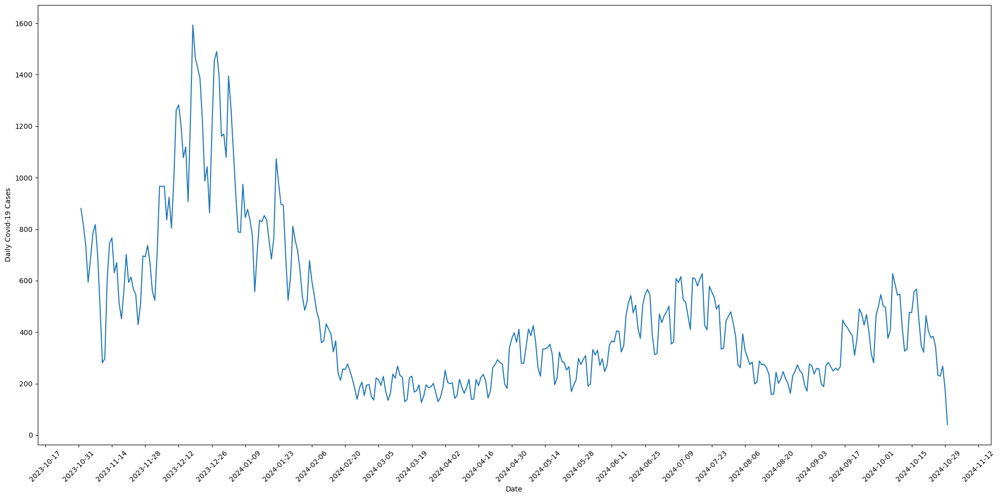

In [9]:

# Ensure the 'date' column is in datetime format
df['date'] = pd.to_datetime(df['date'], dayfirst=True)  # Ensures UK date format (DD/MM/YYYY)

# Filter and group the data
data = df[df['geography'] == 'England']
grouped_data = data.groupby('date').sum()['metric_value'].sort_index()  # Group by date and sort chronologically

# Plot data
plt.figure(figsize=(20, 10))
plt.plot(grouped_data)
plt.xlabel("Date")
plt.ylabel("Daily Covid-19 Cases")

# Use a date locator and formatter for better x-tick readability
plt.gca().xaxis.set_major_locator(mdates.WeekdayLocator(interval=2))  # Display a tick every 2 weeks (adjust as needed)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter("%Y-%m-%d"))

# Rotate x-ticks for readability
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [10]:
data = df[df['geography'] == 'England']
output = data.groupby('date').sum()['metric_value']
output

date
2023-11-01    880
2023-11-02    815
2023-11-03    737
2023-11-04    594
2023-11-05    685
             ... 
2024-10-26    232
2024-10-27    229
2024-10-28    268
2024-10-29    181
2024-10-30     41
Name: metric_value, Length: 365, dtype: int64

In [11]:
for i in range(len(output)):
    oo = output[:i]
    plt.figure(figsize=(20, 10))
    plt.xticks(rotation=90)
    plt.xlabel("Date")
    plt.ylabel("Daily Covid-19 Cases")
    plt.plot(oo)
    plt.savefig(f"./pngs/{i}.png")
    plt.close()

In [12]:
import os

gif_name = 'COVID.gif'
fps = 6
file_list = sorted(glob.glob('./pngs/*.png'), key=os.path.getmtime)
clip = mpy.ImageSequenceClip(file_list, fps=fps)
clip.write_gif('{}'.format(gif_name), fps=fps)

MoviePy - Building file COVID.gif with imageio.


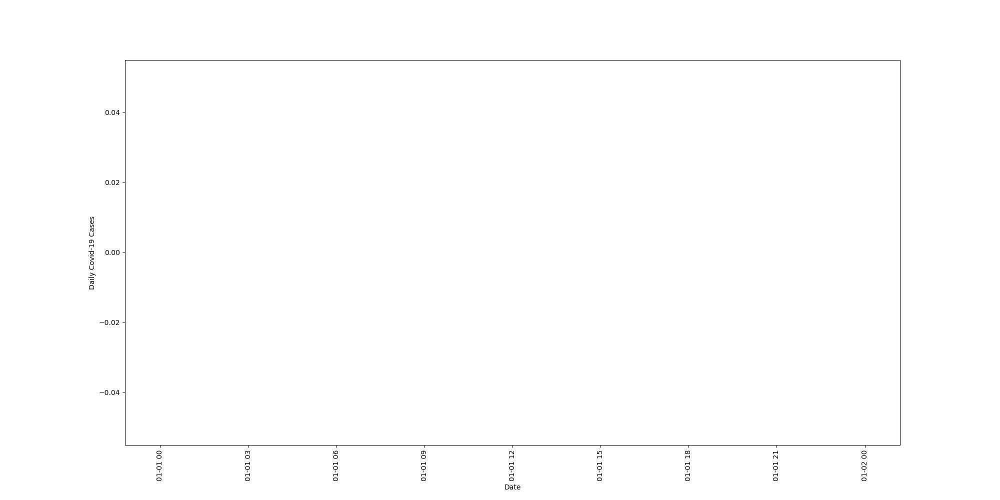

In [13]:
from PIL import Image
from IPython.display import display, Image as IPImage

# Load and display the GIF
with open(gif_name, "rb") as file:
    display(IPImage(data=file.read(), format='gif'))
